# Introduction

Airbnb is a popular online marketplace that allows people to rent out their homes or spare rooms to travelers. It offers a wide range of accommodations, from apartments and houses to unique stays like treehouses and yurts. With Airbnb, travelers can experience a more local and authentic stay while hosts can earn extra income. It's a great platform for both guests and hosts to connect and create memorable experiences.

# About Datasets

Airbnb data for 250,000+ listings in 10 major cities, including information about hosts, pricing, location, and room type, along with over 5 million historical reviews

In [18]:
import numpy as np
import pandas as pd
import datetime as dt
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go

import warnings
warnings.filterwarnings('ignore')
print("[Done]")

[Done]


# Reviews

The columns: listing_id | review_id | date | reviewer_id


In [3]:
reviews = pd.read_csv('Reviews.csv')
reviews.head()

,listing_id,review_id,date,reviewer_id
0,11798,330265172,2018-09-30,11863072
1,15383,330103585,2018-09-30,39147453
2,16455,329985788,2018-09-30,1125378
3,17919,330016899,2018-09-30,172717984
4,26827,329995638,2018-09-30,17542859


In [3]:
reviews.columns

Index(['listing_id', 'review_id', 'date', 'reviewer_id'], dtype='object')

In [5]:
reviews_num_rows = len(reviews)
reviews_num_rows

5373143

In [6]:
reviews.shape

(5373143, 4)

In [9]:
reviews.head

<bound method NDFrame.head of          listing_id  review_id        date  reviewer_id
0             11798  330265172  2018-09-30     11863072
1             15383  330103585  2018-09-30     39147453
2             16455  329985788  2018-09-30      1125378
3             17919  330016899  2018-09-30    172717984
4             26827  329995638  2018-09-30     17542859
...             ...        ...         ...          ...
5373138    47779342  726766332  2021-01-25    283094516
5373139    47823964  727963021  2021-01-31     76411977
5373140    47896175  728548625  2021-02-02     71370946
5373141    47900451  727399287  2021-01-29    109011160
5373142    47998038  730320626  2021-02-11    276790978

[5373143 rows x 4 columns]>

In [10]:
type(reviews)

pandas.core.frame.DataFrame

In [11]:
reviews.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5373143 entries, 0 to 5373142
Data columns (total 4 columns):
 #   Column       Dtype 
---  ------       ----- 
 0   listing_id   int64 
 1   review_id    int64 
 2   date         object
 3   reviewer_id  int64 
dtypes: int64(3), object(1)
memory usage: 164.0+ MB


In [16]:
reviews_duplicates = reviews[reviews.duplicated()]
reviews_duplicates

,listing_id,review_id,date,reviewer_id


There are no duplicate rows 


In [17]:
null_reviews = ['listing_id', 'review_id', 'date', 'reviewer_id']
reviews_null_data = reviews[reviews[null_reviews].isnull().all(axis = 1)]
reviews_null_data

,listing_id,review_id,date,reviewer_id


There are no null values in the specified columns that we require for analysis.

# Listings

### 33 columns

In [4]:
df = pd.read_csv('Listings.csv')
df.head()

,listing_id,name,host_id,host_since,host_location,host_response_time,host_response_rate,host_acceptance_rate,host_is_superhost,host_total_listings_count,...,minimum_nights,maximum_nights,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,instant_bookable
0,281420,"Beautiful Flat in le Village Montmartre, Paris",1466919,2011-12-03,"Paris, Ile-de-France, France",NaN,NaN,NaN,f,1.0,...,2,1125,100.0,10.0,10.0,10.0,10.0,10.0,10.0,f
1,3705183,39 mÂ² Paris (Sacre CÅ“ur),10328771,2013-11-29,"Paris, Ile-de-France, France",NaN,NaN,NaN,f,1.0,...,2,1125,100.0,10.0,10.0,10.0,10.0,10.0,10.0,f
2,4082273,"Lovely apartment with Terrace, 60m2",19252768,2014-07-31,"Paris, Ile-de-France, France",NaN,NaN,NaN,f,1.0,...,2,1125,100.0,10.0,10.0,10.0,10.0,10.0,10.0,f
3,4797344,Cosy studio (close to Eiffel tower),10668311,2013-12-17,"Paris, Ile-de-France, France",NaN,NaN,NaN,f,1.0,...,2,1125,100.0,10.0,10.0,10.0,10.0,10.0,10.0,f
4,4823489,Close to Eiffel Tower - Beautiful flat : 2 rooms,24837558,2014-12-14,"Paris, Ile-de-France, France",NaN,NaN,NaN,f,1.0,...,2,1125,100.0,10.0,10.0,10.0,10.0,10.0,10.0,f


In [8]:
df.columns

Index(['listing_id', 'name', 'host_id', 'host_since', 'host_location',
       'host_response_time', 'host_response_rate', 'host_acceptance_rate',
       'host_is_superhost', 'host_total_listings_count',
       'host_has_profile_pic', 'host_identity_verified', 'neighbourhood',
       'district', 'city', 'latitude', 'longitude', 'property_type',
       'room_type', 'accommodates', 'bedrooms', 'amenities', 'price',
       'minimum_nights', 'maximum_nights', 'review_scores_rating',
       'review_scores_accuracy', 'review_scores_cleanliness',
       'review_scores_checkin', 'review_scores_communication',
       'review_scores_location', 'review_scores_value', 'instant_bookable'],
      dtype='object')

In [18]:
df.shape

(279712, 33)

In [19]:
type(df)

pandas.core.frame.DataFrame

In [12]:
Listings_num_rows = len(df)
Listings_num_rows

279712

In [14]:
cat_cols = ['host_is_superhost', 'host_has_profile_pic', 'host_identity_verified', 'neighbourhood', 'district', 'city', 'property_type', 'room_type', 'instant_bookable']
df[cat_cols] = df[cat_cols].astype('category')

In [15]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 279712 entries, 0 to 279711
Data columns (total 33 columns):
 #   Column                       Non-Null Count   Dtype   
---  ------                       --------------   -----   
 0   listing_id                   279712 non-null  int64   
 1   name                         279539 non-null  object  
 2   host_id                      279712 non-null  int64   
 3   host_since                   279547 non-null  object  
 4   host_location                278872 non-null  object  
 5   host_response_time           150930 non-null  object  
 6   host_response_rate           150930 non-null  float64 
 7   host_acceptance_rate         166625 non-null  float64 
 8   host_is_superhost            279547 non-null  category
 9   host_total_listings_count    279547 non-null  float64 
 10  host_has_profile_pic         279547 non-null  category
 11  host_identity_verified       279547 non-null  category
 12  neighbourhood                279712 non-null

In [20]:
Listings_duplicates = df[df.duplicated()]
Listings_duplicates

,listing_id,name,host_id,host_since,host_location,host_response_time,host_response_rate,host_acceptance_rate,host_is_superhost,host_total_listings_count,...,minimum_nights,maximum_nights,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,instant_bookable


There are no duplicate rows in our data


In [32]:
null_Listings = ['listing_id', 'name', 'host_id', 'host_since', 'host_location',
       'host_response_time', 'host_response_rate', 'host_acceptance_rate',
       'host_is_superhost', 'host_total_listings_count',
       'host_has_profile_pic', 'host_identity_verified', 'neighbourhood',
       'district', 'city', 'latitude', 'longitude', 'property_type',
       'room_type', 'accommodates', 'bedrooms', 'amenities', 'price',
       'minimum_nights', 'maximum_nights', 'review_scores_rating',
       'review_scores_accuracy', 'review_scores_cleanliness',
       'review_scores_checkin', 'review_scores_communication',
       'review_scores_location', 'review_scores_value', 'instant_bookable']
Listings_null_data = df[df[null_Listings].isnull().all(axis = 1)]
Listings_null_data

,listing_id,name,host_id,host_since,host_location,host_response_time,host_response_rate,host_acceptance_rate,host_is_superhost,host_total_listings_count,...,minimum_nights,maximum_nights,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,instant_bookable


In [22]:

df['host_since'] = pd.to_datetime(df['host_since'])


df['year_month'] = df["host_since"].dt.to_period('M')
df.head()

,listing_id,name,host_id,host_since,host_location,host_response_time,host_response_rate,host_acceptance_rate,host_is_superhost,host_total_listings_count,...,maximum_nights,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,instant_bookable,year_month
0,281420,"Beautiful Flat in le Village Montmartre, Paris",1466919,2011-12-03,"Paris, Ile-de-France, France",NaN,NaN,NaN,f,1.0,...,1125,100.0,10.0,10.0,10.0,10.0,10.0,10.0,f,2011-12
1,3705183,39 mÂ² Paris (Sacre CÅ“ur),10328771,2013-11-29,"Paris, Ile-de-France, France",NaN,NaN,NaN,f,1.0,...,1125,100.0,10.0,10.0,10.0,10.0,10.0,10.0,f,2013-11
2,4082273,"Lovely apartment with Terrace, 60m2",19252768,2014-07-31,"Paris, Ile-de-France, France",NaN,NaN,NaN,f,1.0,...,1125,100.0,10.0,10.0,10.0,10.0,10.0,10.0,f,2014-07
3,4797344,Cosy studio (close to Eiffel tower),10668311,2013-12-17,"Paris, Ile-de-France, France",NaN,NaN,NaN,f,1.0,...,1125,100.0,10.0,10.0,10.0,10.0,10.0,10.0,f,2013-12
4,4823489,Close to Eiffel Tower - Beautiful flat : 2 rooms,24837558,2014-12-14,"Paris, Ile-de-France, France",NaN,NaN,NaN,f,1.0,...,1125,100.0,10.0,10.0,10.0,10.0,10.0,10.0,f,2014-12


In [8]:
df.groupby("room_type")["review_scores_cleanliness","price"].mean().round(2)


,review_scores_cleanliness,price
room_type,,
Entire place,9.34,673.35
Hotel room,9.33,800.21
Private room,9.26,462.44
Shared room,9.05,579.92


# Margeing Reviews and  Listings


In [29]:
marge_df  = df.merge(reviews, how = 'inner', on = 'listing_id')
marge_df.head()

,listing_id,name,host_id,host_since,host_location,host_response_time,host_response_rate,host_acceptance_rate,host_is_superhost,host_total_listings_count,...,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,instant_bookable,review_id,date,reviewer_id
0,281420,"Beautiful Flat in le Village Montmartre, Paris",1466919,2011-12-03,"Paris, Ile-de-France, France",NaN,NaN,NaN,f,1.0,...,10.0,10.0,10.0,10.0,10.0,10.0,f,173279221,2017-07-23,3501898
1,281420,"Beautiful Flat in le Village Montmartre, Paris",1466919,2011-12-03,"Paris, Ile-de-France, France",NaN,NaN,NaN,f,1.0,...,10.0,10.0,10.0,10.0,10.0,10.0,f,172657766,2017-07-21,74346703
2,3705183,39 mÂ² Paris (Sacre CÅ“ur),10328771,2013-11-29,"Paris, Ile-de-France, France",NaN,NaN,NaN,f,1.0,...,10.0,10.0,10.0,10.0,10.0,10.0,f,20792760,2014-10-05,21583508
3,3705183,39 mÂ² Paris (Sacre CÅ“ur),10328771,2013-11-29,"Paris, Ile-de-France, France",NaN,NaN,NaN,f,1.0,...,10.0,10.0,10.0,10.0,10.0,10.0,f,32282670,2015-05-16,32285553
4,3705183,39 mÂ² Paris (Sacre CÅ“ur),10328771,2013-11-29,"Paris, Ile-de-France, France",NaN,NaN,NaN,f,1.0,...,10.0,10.0,10.0,10.0,10.0,10.0,f,45645391,2015-09-04,34310199


In [25]:
marge_df['month'] = pd.to_datetime(marge_df['date']).dt.month
marge_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 5373143 entries, 0 to 5373142
Data columns (total 38 columns):
 #   Column                       Dtype         
---  ------                       -----         
 0   listing_id                   int64         
 1   name                         object        
 2   host_id                      int64         
 3   host_since                   datetime64[ns]
 4   host_location                object        
 5   host_response_time           object        
 6   host_response_rate           float64       
 7   host_acceptance_rate         float64       
 8   host_is_superhost            category      
 9   host_total_listings_count    float64       
 10  host_has_profile_pic         category      
 11  host_identity_verified       category      
 12  neighbourhood                category      
 13  district                     category      
 14  city                         category      
 15  latitude                     float64       
 16  

Marge reviews and Listings with list of type columns

In [26]:
marge_df.tail(10)


,listing_id,name,host_id,host_since,host_location,host_response_time,host_response_rate,host_acceptance_rate,host_is_superhost,host_total_listings_count,...,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,instant_bookable,year_month,review_id,date,reviewer_id,month
5373133,38338635,Appartement T2 neuf prÃ¨s du tram T3a Porte Didot,31161181,2015-04-13,"Paris, Ile-de-France, France",NaN,NaN,NaN,f,1.0,...,10.0,10.0,10.0,10.0,f,2015-04,532591323,2019-09-20,21027982,9
5373134,38338635,Appartement T2 neuf prÃ¨s du tram T3a Porte Didot,31161181,2015-04-13,"Paris, Ile-de-France, France",NaN,NaN,NaN,f,1.0,...,10.0,10.0,10.0,10.0,f,2015-04,592890978,2020-01-14,21027982,1
5373135,38538692,Cozy Studio in Montmartre,10294858,2013-11-27,"Paris, Ile-de-France, France",NaN,NaN,NaN,f,1.0,...,10.0,10.0,10.0,10.0,f,2013-11,593653929,2020-01-16,180744800,1
5373136,38538692,Cozy Studio in Montmartre,10294858,2013-11-27,"Paris, Ile-de-France, France",NaN,NaN,NaN,f,1.0,...,10.0,10.0,10.0,10.0,f,2013-11,604467174,2020-02-11,1902376,2
5373137,38683356,Nice and cosy mini-appartement in Paris,2238502,2012-04-27,"Paris, Ile-de-France, France",NaN,NaN,NaN,f,1.0,...,10.0,10.0,10.0,10.0,f,2012-04,546207032,2019-10-13,155005299,10
5373138,38683356,Nice and cosy mini-appartement in Paris,2238502,2012-04-27,"Paris, Ile-de-France, France",NaN,NaN,NaN,f,1.0,...,10.0,10.0,10.0,10.0,f,2012-04,532395580,2019-09-19,10347403,9
5373139,38683356,Nice and cosy mini-appartement in Paris,2238502,2012-04-27,"Paris, Ile-de-France, France",NaN,NaN,NaN,f,1.0,...,10.0,10.0,10.0,10.0,f,2012-04,553159713,2019-10-23,197011717,10
5373140,39659000,Charming apartment near Rue Saint Maur / Oberk...,38633695,2015-07-16,"Paris, Ile-de-France, France",NaN,NaN,NaN,f,1.0,...,10.0,10.0,10.0,10.0,f,2015-07,556350613,2019-10-29,102836346,10
5373141,40219504,Cosy apartment with view on Canal St Martin,6955618,2013-06-17,"Paris, Ile-de-France, France",NaN,NaN,NaN,f,1.0,...,10.0,10.0,10.0,10.0,f,2013-06,597833586,2020-01-26,21707358,1
5373142,40219504,Cosy apartment with view on Canal St Martin,6955618,2013-06-17,"Paris, Ile-de-France, France",NaN,NaN,NaN,f,1.0,...,10.0,10.0,10.0,10.0,f,2013-06,603384165,2020-02-09,76518059,2


In [50]:
plt.figure(figsize=(20,7))
px.scatter(df, x="bedrooms",y="price",animation_frame="room_type")

<Figure size 1440x504 with 0 Axes>

<AxesSubplot:xlabel='bedrooms', ylabel='price'>

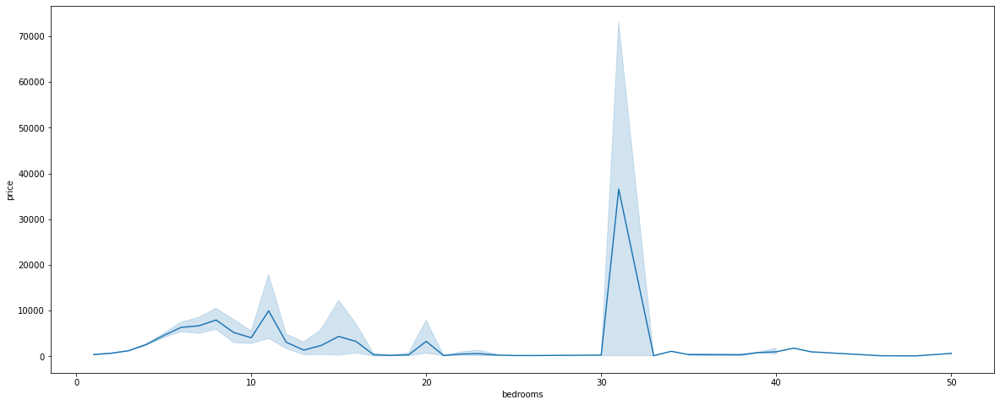

In [12]:
plt.figure(figsize=(20,8))
sns.lineplot(data=df, x="bedrooms",y="price")

### Which neighbourhood has the highest listing?

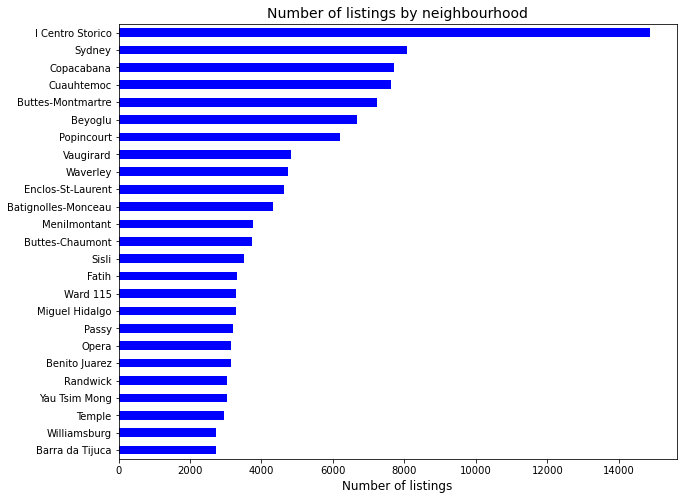

In [5]:
#Which neighbourhood has the highest listing?
feq = df['neighbourhood'].value_counts().sort_values(ascending=True)
feq = feq[-25:]
feq.plot.barh(figsize=(10,8), color ='b', width= 0.5)
plt.title('Number of listings by neighbourhood', fontsize=14)
plt.xlabel('Number of listings', fontsize = 12)
plt.show()

In [8]:
df.room_type.unique()


array(['Entire place', 'Private room', 'Hotel room', 'Shared room'],
      dtype=object)

# Type of properties available

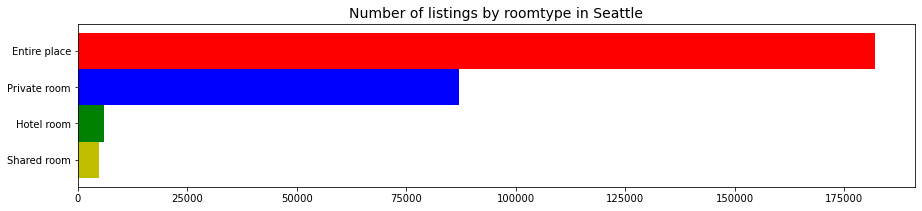

In [51]:
#Type of properties available
freq = df['room_type'].value_counts().sort_values(ascending=True)
freq.plot.barh(figsize =(15,3), width=1, color=['y','g','b','r'])
                                            #We give four different colours for our graphs
plt.title("Number of listings by roomtype in Seattle", fontsize=14)
plt.show()

# Number of guests 

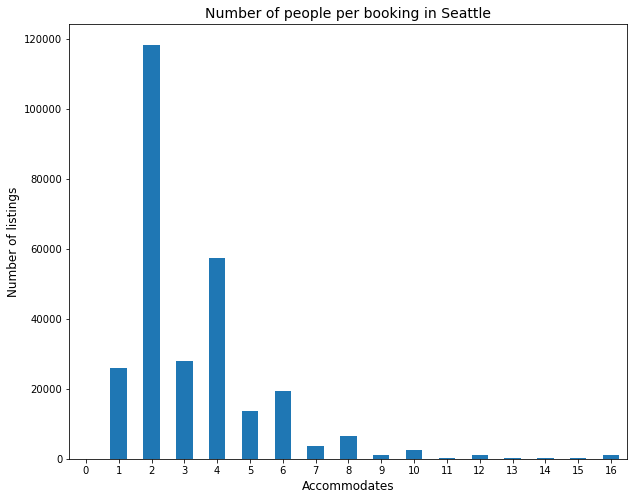

In [10]:
#Number of guests 
feq = df['accommodates'].value_counts().sort_index()
feq.plot.bar(figsize=(10,8), width=0.5, rot=0)
plt.title('Number of people per booking in Seattle', fontsize=14)
plt.ylabel('Number of listings', fontsize=12)
plt.xlabel('Accommodates', fontsize=12)
plt.show()

# Check availability

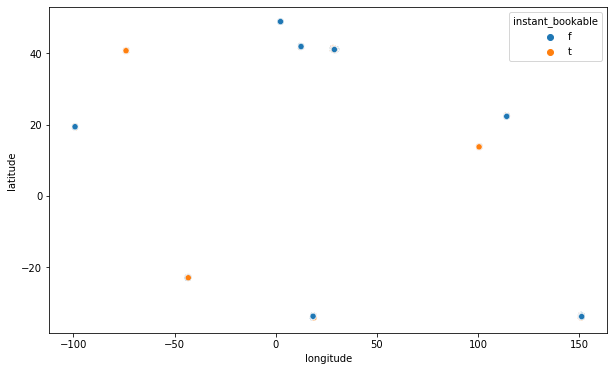

In [42]:
plt.figure(figsize=(10,6))
sns.scatterplot(marge_df.longitude,marge_df.latitude,hue=marge_df.instant_bookable)
plt.ioff()

Checking availability

# Price Prediction - Future 

In [ ]:
marge_df  = df.merge(reviews, how = 'inner', on = 'listing_id')
marge_df.head()

In [24]:
#Price Prediction
listing_calendar = pd.read_csv("calendar.csv")
listing_calendar.head(10).dropna()

,listing_id,date,available,price
0,241032,2016-01-04,t,$85.00
1,241032,2016-01-05,t,$85.00
9,241032,2016-01-13,t,$85.00


In [26]:
listing_calendar['price'] = listing_calendar['price'].apply(lambda x: str(x).replace('$',''))
listing_calendar['price'] = pd.to_numeric(listing_calendar['price'], errors = 'coerce')
df_calendar = listing_calendar.groupby('date')[["price"]].sum()
df_calendar['mean'] = listing_calendar.groupby('date')[["price"]].mean()
df_calendar.columns = ['Total', 'Avg']

In [27]:
df_calendar2 = listing_calendar.set_index("date")
df_calendar2.index = pd.to_datetime(df_calendar2.index)
df_calendar2 = df_calendar2[['price']].resample('M').mean()

In [49]:
#Plot average monthly prices
trace3 = go.Scatter(
    x = df_calendar2.index[:-1],
    y = df_calendar2.price[:-1]
)
layout3 = go.Layout(
    title = "Average Prices by Month",
    xaxis = dict(title = 'Month'),
    yaxis = dict(title = 'Price ($)')
)
data3 = [trace3]
figure3 = go.Figure(data = data3, layout = layout3)
figure3

In [43]:
from sklearn.linear_model import LogisticRegression
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix
from sklearn.metrics import r2_score

In [44]:
x = marge_df.iloc[:,[0,1,3,4,5]]
y = marge_df['price']
#Getting Test and Training Set
x_train,x_test,y_train,y_test=train_test_split(x,y,test_size=.1,random_state=353)
x_train.head()
y_train.head()

5001805     171
3181089     150
3133784     380
5262767      78
2916017    2200
Name: price, dtype: int64

In [45]:
x_train.shape


(4835828, 5)

# Visualization

city
Paris             64690
New York          37012
Sydney            33630
Rome              27647
Rio de Janeiro    26615
Istanbul          24519
Mexico City       20065
Bangkok           19361
Cape Town         19086
Hong Kong          7087
Name: instant_bookable, dtype: int64


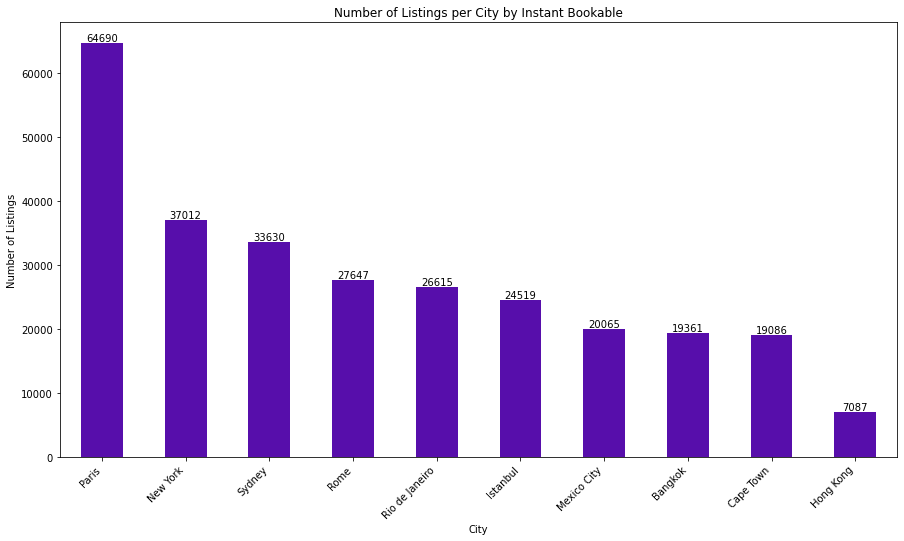

In [3]:
city_instantbookable = df.groupby('city')['instant_bookable'].count().sort_values(ascending = False)
print(city_instantbookable)


plt.figure(figsize = (15,8))
city_instantbookable.plot(kind = 'bar', color = '#570eab')
plt.title('Number of Listings per City by Instant Bookable')
plt.xlabel('City')
plt.ylabel('Number of Listings')
plt.xticks(rotation = 45, ha = 'right')
for i, v in enumerate(city_instantbookable):
    plt.text(i, v, str(v), ha='center', va='bottom')
plt.show()

Paris has the highest number of instant bookings with a total of 64690 bookings and Hong Kong has the least number of instant bookings with 7087.

In [28]:
numerics = ['accommodates', 'bedrooms', 'minimum_nights', 'maximum_nights','review_scores_rating',
            'review_scores_accuracy', 'review_scores_cleanliness', 'review_scores_checkin',
            'review_scores_communication', 'review_scores_location', 'review_scores_value']

numeric_df = df[numerics + ['price']]


correlation_matrix = numeric_df.corr()


price_correlation = correlation_matrix['price'].sort_values(ascending = False)


print(price_correlation)

price                          1.000000
accommodates                   0.146327
bedrooms                       0.143307
review_scores_cleanliness      0.024328
review_scores_rating           0.015048
minimum_nights                 0.006344
review_scores_value            0.001572
review_scores_checkin         -0.000243
maximum_nights                -0.000442
review_scores_location        -0.000609
review_scores_accuracy        -0.000693
review_scores_communication   -0.003262
Name: price, dtype: float64


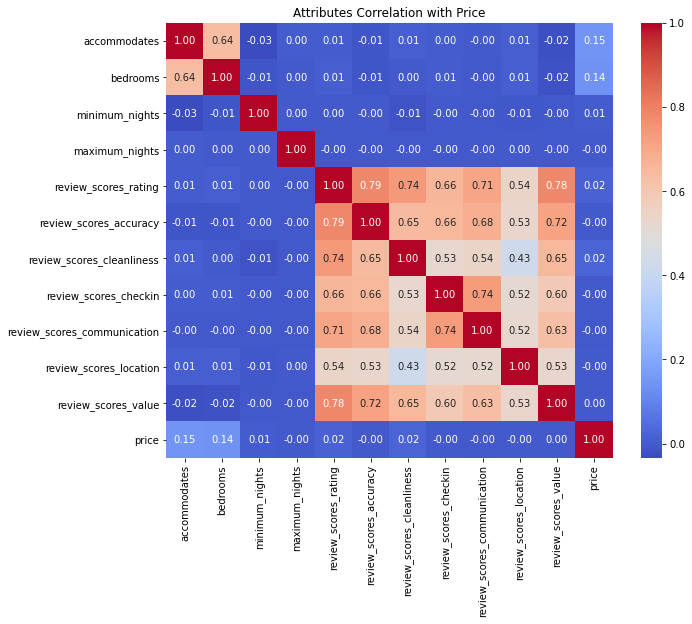

In [29]:


plt.figure(figsize = (10,8))
sns.heatmap(correlation_matrix, annot = True, cmap = 'coolwarm', fmt = '.2f')
plt.title('Attributes Correlation with Price')
plt.show()


From the above correlation matrix, we can observe that review score rating, review scores cleanliness, accomodates and bedrooms have the highest influence on price.

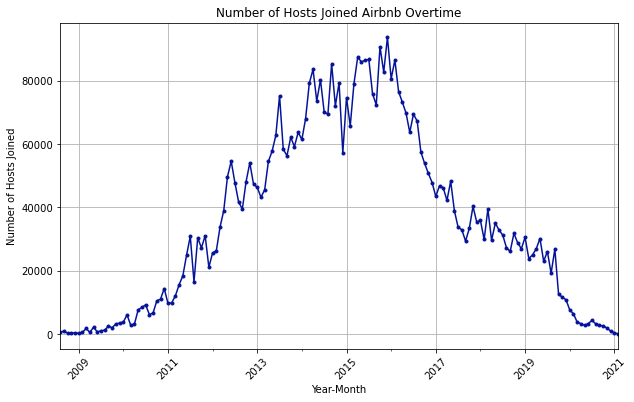

In [30]:

hosts_per_month = marge_df['year_month'].value_counts().sort_index()

#plot the trend of hosts joining 
plt.figure(figsize = (10,6))
hosts_per_month.plot(kind = 'line', marker = '.', color = '#051399')
plt.title('Number of Hosts Joined Airbnb Overtime')
plt.xlabel('Year-Month')
plt.ylabel('Number of Hosts Joined')
plt.xticks(rotation = 45)
plt.grid(True)
plt.show()

Able to identify any trends or seasonality in the review data,From the above graph, we can observe that there is an huge increase in the hosts who joined Airbnb during the years 2015 and 2017. And suddenly there was a downward trend in the year 2017

In [32]:
datewise_bookings = marge_df['date'].value_counts().sort_values(ascending = False)
datewise_bookings

2020-01-02    10136
2020-01-01     9635
2019-10-06     9423
2019-11-03     8937
2019-09-29     8905
              ...  
2010-04-20        1
2008-11-28        1
2009-12-24        1
2009-12-29        1
2010-03-26        1
Name: date, Length: 4103, dtype: int64

10136 rooms were booked in a single day of 2020-01-02. In the months of September and October there are a huge number of rooms booked with airbnb

Which city offers a better value for travel?

city
Rome               105.107643
Paris              113.096445
New York           142.842240
Sydney             222.013440
Istanbul           532.557445
Rio de Janeiro     742.589254
Hong Kong          746.169889
Mexico City       1149.253028
Bangkok           2078.278033
Cape Town         2405.120350
Name: price, dtype: float64


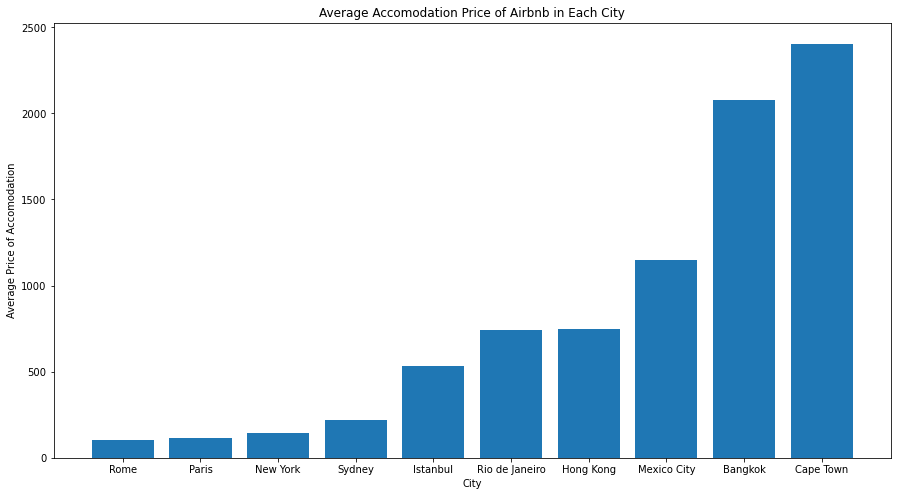

In [35]:
#calculate the average price for accomodations in each city

avg_price_city = df.groupby('city')['price'].mean().sort_values()
print(avg_price_city)


plt.figure(figsize = (15,8))
plt.bar(avg_price_city.index, avg_price_city.values)
plt.title('Average Accomodation Price of Airbnb in Each City')
plt.ylabel('Average Price of Accomodation')
plt.xlabel('City')
plt.show()

calculate the average price for accomodations in each city

# Conclusion

the Airbnb dataset is a rich collection of information about Airbnb listings, including details about properties, hosts, and reviews. Researchers and analysts use this dataset to explore various questions related to pricing, neighborhood preferences, and trends in short-term rentals. It empowers data-driven decision-making and provides insights into the dynamic world of home-sharing